## Энергетический оракул
Ноутбук команды #12

Работа выполнена на основе модели LightGBM


### 1. Подготовка данных

In [278]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import lightgbm as lgb
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import r2_score

import re

from tqdm import tqdm

random_state = 12345
NUM_ITERATIONS = 5000

In [307]:
def mae_day(y_true, y_pred):
    y_true_copy = pd.DataFrame(y_true).reset_index(drop=True)
    y_true_copy['day'] = y_true_copy.index // 24
    y_true_grouped = y_true_copy.groupby(by='day').sum()   
    y_pred_copy = pd.DataFrame(y_pred).reset_index(drop=True)
    y_pred_copy['day'] = y_pred_copy.index // 24
    y_pred_grouped = y_pred_copy.groupby(by='day').sum()
    
    return mean_absolute_error(y_true_grouped, y_pred_grouped)

#### 1.1 Функции для расшифровки прогноза погоды в колонке 'weather_pred'

In [279]:
# Расшифровка прогноза в колонке 'weather_pred'

# функция формирует колонки 'cloudy', 'rainy', 'windy', 'clear', 'rain_probability', 'has_rain_probability'
# в колонках число, которое 0 при отсутсвии упоминания явления в weather_pred или степень упоминания
# функция дает в колонках номер первого списка, элемент которого есть в строке плюс 1
# списки cloudy_list, rainy_list, windy_list, clear_list можно модифицировать
# соответственно, можно экспериментировать с расположением значений в списках
# например, сейчас 'дождь', 'снег', 'д+сн' - первая степень  дождя, а 'гроз', 'ливень' - вторая
# а можно сделать снег второй, а грозу с ливнем убрать в третью
# также сделал отдельный список для "ясности", чтобы выделить 'ясно' и 'солнечно'

def in_what_list(weather, big_list):
    for list_number, small_list in enumerate(big_list):
        if any(word in weather for word in small_list):
            return list_number+1
    return 0

def weather_split2(row):
    weather = row['weather_pred']
    cloudy_list = [['проясн', 'пер.об.', 'п/об'], ['пасм', 'обл']]
    rainy_list = [['дождь', 'снег', 'д+сн'], ['гроз', 'ливень']]
    windy_list = [['вет'],['штор']]
    clear_list = [['проясн'], ['ясно'], ['солнеч']]
    numbers = re.findall(r'\d+', weather)
    cloudy = in_what_list(weather, cloudy_list)
    rainy = in_what_list(weather, rainy_list)
    windy = in_what_list(weather, windy_list)
    clear = in_what_list(weather, clear_list)
    rain_probability = 0 if len(numbers)==0 else int(numbers[0])
    has_rain_probability = int(len(numbers)==0)
    return cloudy, rainy, windy, clear, rain_probability, has_rain_probability

def fill_weather_columns(df):
    df['weather_pred'] = df['weather_pred'].fillna('')
    df['cloudy'], df['rainy'], df['windy'], df['clear'], df['rain_probability'], df['has_rain_probability'] = \
                zip(*df.apply(weather_split2, axis=1))
    return df

#### 1.2 Функции для загрузки данных о ВВП 
данные загружаются из файла 'data/VVP.csv'

Некоторые научные работы указывают на прямую связь величины потребления электричества и показателя ВВП, который отражает ситуацию в экономике. Данные по экономике публикуются различными министерствами с разной периодичностью. Для использования в работе были взяты фактические данные по ВВП с сайта investing, который агрегирует публикации Минэкономразвития. Данные за месяц побликуются с месячной задержкой, поэтому модель использует для прогнозирования данные за прошлые месяцы, которые известны.   
  
Ссылка на данные: https://ru.investing.com/economic-calendar/russian-monthly-gdp-407


In [280]:
# Функция добавляет данные о ВВП из файла 'data/VVP.csv' в датасет

def add_vvp2(data, file_source = 'data/VVP.csv'):
    """
    сырой датафрем подаем на вход
    """
    # обработаем файл с динамикой ВВП
    vvp = pd.read_csv(file_source)
    # преобразуем дату файла-источника в формат datetime64 и дропнем один столбик
    vvp['date'] = pd.to_datetime(vvp['date'], format ='%Y-%m-%d %H:%M:%S')
    vvp.drop('for_month',axis=1,inplace=True) 
    
    # обработаем основной фрейм - создадим столбец для соединения, который потом удалим
    data['date_temp'] = pd.to_datetime(data['date'], format = '%Y-%m-%d' )
    data['date_temp'] = data['date_temp'] + pd.to_timedelta(data['time'] , 'H')
    
    # соединяем основной фрейм и ВВП по дате объявления показтеля ВВП
    for idx in reversed(vvp.index):
        data.loc[data['date_temp']>=vvp.date[idx],'VVP'] = vvp.VVP_perc[idx]
        
    data.drop('date_temp',axis=1,inplace=True)   

    return data

#### 1.3 Функции для загрузки архива данных о фактической погоде
данные загружаются из файла 'data/preprocessing_loaded_table.csv'

Изначально данные для формирования таблицы "preprocessing_loaded_table" были взяты из с сайта [https://rp5.ru](https://rp5.ru/Архив_погоды_в_Храброво,_им._императрицы_Елизаветы_Петровны_(аэропорт),_METAR), где хранятся архивы погоды в аэрапорту Калининграда, за период с 31.12.2018 по 30.09.2023

Описание данных в таблице:
- Местное время в Храброво / им. императрицы Елизаветы Петровны (аэропорт) - Дата / Местное время
- T -  Темпиратура воздуха
- Po - Давление на уровне станции
- P - Давление приведённое к уровню моря
- U - Относительная влажность
- DD - Направление ветра
- Ff - Скорость ветра
- ff10 - Максимальное значение порыва ветра
- WW - Особое явление текущей погоды (осадки)
- W'W' - Явление недавней погоды, имеющее оперативное значение
- с - Общая облачность
- VV - Горизонтальная дальность видимости
- Td - Темпиратура точки росы

Данные, которые были взяты из данной таблицы и загружаются из 'data/preprocessing_loaded_table.csv':
- P - не подверглось изменению
- U - не подверглось изменению
- Td - не подверглась изменению

 WW - разделили на 4 категории:
- Нет осадков (где были пропуски)
- слабый дождь
- сильный дождь
- снег

DD - создали 4 столбца, соответствующих сторонам горизонта, которые принимали значения 0; 0.5 и 1 в зависимости от силы ветра в конкретном направлении
- N - north
- S - south
- W - west
- E - east

В дальнейшем эти данные использовались с лагом в сутки: в поля на завтрашний день записывались данные сегодняшнего.

In [281]:
# Функции для работы с данными о фактической погоде из 'data/preprocessing_loaded_table.csv'

# Кодировка информации об осадках из колонки WW
def true_weather_WW_replace(ww):
    if ww=='нет осадков':
        return 0
    elif ww=='слабый дождь':
        return 1
    elif (ww=='сильный дождь') or (ww=='снег'):
        return 2
    else:
        return 3

# Вычисление Timestamp из даты и времени
def row_plus_hours_to_index(row):
    return row['date'] + pd.to_timedelta(row['time'] , 'H')

# Функция для сдвига на сутки (в скачанном датасете разбивка по 30 мин, поэтому timeshift=48)
def shift_features_fact(df, timeshift=48):
    list_fact_columns=list(df.columns)
    list_fact_columns.remove('date_tw')
    new_df = df.copy()
    for column in list_fact_columns:
        new_df[column] = new_df[column].shift(timeshift)

    return new_df

In [282]:
# Функция для вычисления метрики mae по дням из почасовых массивов данных

def mae_day(y_true, y_pred):
    y_true_copy = pd.DataFrame(y_true).reset_index(drop=True)
    y_true_copy['day'] = y_true_copy.index // 24
    y_true_grouped = y_true_copy.groupby(by='day').sum()   
    y_pred_copy = pd.DataFrame(y_pred).reset_index(drop=True)
    y_pred_copy['day'] = y_pred_copy.index // 24
    y_pred_grouped = y_pred_copy.groupby(by='day').sum()
    
    return mean_absolute_error(y_true_grouped, y_pred_grouped)
# Функция для вычисления метрик по дням из почасовых массивов данных

def metrics_hour(y_true, y_pred):

    
    mae = mean_absolute_error(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    return mae, mape, r2

#### 1.5 Чтение файлов с данными
Данные объединяются в один датасет

In [283]:
# читаем исходные датасеты и складываем в один
train_ds = pd.read_csv('data/train_dataset.csv')
test_ds = pd.read_csv('data/test_dataset.csv')
train_ds = pd.concat([train_ds, test_ds])

# запоминаем дату начала тестовых данных, потом также поступим и с закрытым датасетом
open_test_begin = pd.to_datetime(test_ds['date']).min()
open_test_end = pd.to_datetime(test_ds['date']).max() + pd.to_timedelta(1,'d')
print('начало открытого теста:', open_test_begin, '    конец открытого теста:', open_test_end)

начало открытого теста: 2023-04-01 00:00:00     конец открытого теста: 2023-08-01 00:00:00


#### 1.6 Формирование колонок с производными от даты

In [284]:
# преобразуем дату и делаем из нее колонки
train_ds['date'] = pd.to_datetime(train_ds['date'])
train_ds['year'] = train_ds['date'].dt.year
train_ds['month'] = train_ds['date'].dt.month
train_ds['day_of_week'] = train_ds['date'].dt.dayofweek
train_ds['day'] = train_ds['date'].dt.day
train_ds['day_of_year'] = train_ds['date'].dt.dayofyear

#### 1.7 Подгрузка данных о праздниках

In [285]:
# Добавление данных о праздниках из файла 'data/holidays.csv'

df_holidays = pd.read_csv('data/holidays.csv')
df_holidays['date'] = pd.to_datetime(df_holidays['date'])

# Assuming df_holidays and train_ds are your dataframes
train_ds = pd.merge(train_ds, df_holidays, on='date', how='left')

# Fill NaN values with 0
train_ds['holidays'].fillna(0, inplace=True)
train_ds['preholidays'].fillna(0, inplace=True)

# Convert to int
train_ds['holidays'] = train_ds['holidays'].astype(int)
train_ds['preholidays'] = train_ds['preholidays'].astype(int)

#### 1.8 Формирование колонок со значением целевого признака в предыдущие дни

In [286]:
# Добавление колонок с временными лагами

# создаем столбец 'temp_last_day'
train_ds['temp_last_day'] = train_ds['temp'].shift(24)

# заполняем пропущенные значения в 'temp_last_day'
train_ds['temp_last_day'].fillna(method='bfill', inplace=True)

# создаем столбцы с временными лагами для 'target'
lags = [1, 12, 24, 48, 72, 7*24, 14*24]
for lag in lags:
    train_ds[f'target_lag_{lag}'] = train_ds['target'].shift(lag)

"""count_rollins = [24,
                    #7*24, 
                    #28*24,
                    #56*24
                    ] 
for count_rollin in count_rollins:  
    train_ds[f'mean_{count_rollin}'] = train_ds['target_lag_24'].rolling(count_rollin).mean()

count_rollins = [24, 7*24, 28*24] 
for count_rollin in count_rollins:  
    train_ds[f'temp_mean_{count_rollin}'] = train_ds['temp'].rolling(count_rollin).mean().shift(24)"""
# заполняем пропущенные значения в столбцах с лагами
for lag in lags:
    train_ds[f'target_lag_{lag}'].fillna(0, inplace=True)

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/2154073013.py:7: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  train_ds['temp_last_day'].fillna(method='bfill', inplace=True)


#### 1.9 Формирование колонок с ВВП и данными о погоде посредством ранее описанных функций

In [287]:
# применяем функцию добавления ВВП
train_ds = add_vvp2(train_ds)

# Расшифровка прогноза в колонке 'weather_pred'
train_ds = fill_weather_columns(train_ds)


# Читаем файл с архивом фактической погоды
df_true_weather = pd.read_csv('data/preprocessing_loaded_table.csv')
display(df_true_weather)

# Форматируем колонки
df_true_weather['WW'] = df_true_weather['WW'].apply(true_weather_WW_replace)
df_true_weather['date'] = pd.to_datetime(df_true_weather['date'])
df_true_weather = df_true_weather.rename(columns={'date':'date_tw'})
# Применяем сдвиг на сутки, чтобы не заглядывать в будущее
df_true_weather = shift_features_fact(df_true_weather)
# Добавляем в датасет
train_ds['date_hours'] = train_ds.apply(row_plus_hours_to_index, axis=1)
train_ds = train_ds.merge(df_true_weather, left_on='date_hours', right_on='date_tw')
train_ds = train_ds.drop(['date_hours', 'date_tw'], axis=1)

,date,P,U,WW,Td,N,S,W,E
0,2018-12-31 00:00:00,763.5,100.0,слабый дождь,2.0,1.0,0.0,0.0,0.0
1,2018-12-31 00:30:00,764.3,93.0,слабый дождь,1.0,1.0,0.0,0.0,0.5
2,2018-12-31 01:00:00,764.3,93.0,слабый дождь,1.0,1.0,0.0,0.0,0.0
3,2018-12-31 01:30:00,765.0,93.0,слабый дождь,2.0,1.0,0.0,0.0,0.0
4,2018-12-31 02:00:00,765.0,93.0,нет осадков,2.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
82146,2023-09-30 21:30:00,763.5,82.0,нет осадков,12.0,0.0,0.0,1.0,0.0
82147,2023-09-30 22:00:00,763.5,82.0,нет осадков,12.0,0.5,0.0,1.0,0.0
82148,2023-09-30 22:30:00,763.5,77.0,сильный дождь,11.0,0.0,0.0,1.0,0.0
82149,2023-09-30 23:00:00,763.5,94.0,сильный дождь,13.0,0.5,0.0,1.0,0.0


#### 1.10 Демонстрация сформированного датасета

In [288]:
# Итоговый набор колонок
train_ds.columns

Index(['date', 'time', 'target', 'temp', 'temp_pred', 'weather_pred',
       'weather_fact', 'year', 'month', 'day_of_week', 'day', 'day_of_year',
       'holidays', 'preholidays', 'temp_last_day', 'target_lag_1',
       'target_lag_12', 'target_lag_24', 'target_lag_48', 'target_lag_72',
       'target_lag_168', 'target_lag_336', 'VVP', 'cloudy', 'rainy', 'windy',
       'clear', 'rain_probability', 'has_rain_probability', 'P', 'U', 'WW',
       'Td', 'N', 'S', 'W', 'E'],
      dtype='object')

In [289]:
train_ds.head()

,date,time,target,temp,temp_pred,weather_pred,weather_fact,year,month,day_of_week,...,rain_probability,has_rain_probability,P,U,WW,Td,N,S,W,E
0,2019-01-01,0,481.510,2.9,2.0,"пасм, ветер",ветер,2019,1,1,...,0,1,763.5,100.0,1.0,2.0,1.0,0.0,0.0,0.0
1,2019-01-01,1,462.872,2.9,2.0,"пасм, ветер",ветер,2019,1,1,...,0,1,764.3,93.0,1.0,1.0,1.0,0.0,0.0,0.0
2,2019-01-01,2,449.718,2.9,2.0,"пасм, ветер",ветер,2019,1,1,...,0,1,765.0,93.0,0.0,2.0,1.0,0.0,0.0,0.0
3,2019-01-01,3,430.908,4.3,2.0,"пасм, ветер","ветер, пасм",2019,1,1,...,0,1,765.8,87.0,0.0,1.0,1.0,0.0,0.0,0.0
4,2019-01-01,4,415.163,4.3,2.0,"пасм, ветер","ветер, пасм",2019,1,1,...,0,1,766.6,87.0,0.0,1.0,1.0,0.0,0.0,0.0


#### 1.11 Исключение лишних колонок

In [290]:
# Отбираем признаки. Все лишние колонки здесь отбрасываем, кроме 'date', которую уберем позже 

feature_cols = list(train_ds.columns)

# выбрасываем взгляд в прошлое и расшифрованную погоду
drop_list = ['target', 'day_of_year', 'weather_pred', 'weather_fact', 'temp']

# выбрасываем признаки, найденные процедурно в процессе оптимизации
# КОМАНДЕ: здесь можно добавлять признаки на выброс с целью оптимизации
drop_list = drop_list + ['target_lag_48', 'target_lag_168'] #, 'temp_pred'] #, 'target_lag_336'] 

for name in drop_list:
    feature_cols.remove(name)

# Итоговый список признаков
feature_cols

['date',
 'time',
 'temp_pred',
 'year',
 'month',
 'day_of_week',
 'day',
 'holidays',
 'preholidays',
 'temp_last_day',
 'target_lag_1',
 'target_lag_12',
 'target_lag_24',
 'target_lag_72',
 'target_lag_336',
 'VVP',
 'cloudy',
 'rainy',
 'windy',
 'clear',
 'rain_probability',
 'has_rain_probability',
 'P',
 'U',
 'WW',
 'Td',
 'N',
 'S',
 'W',
 'E']

#### 1.12 Выделение наборов данных для обучения, валидации и тестирования

Выделялось два набора данных для обучения и валидации:
1. Обучение на данных с 2019 по 2021 с валидацией на 2022
2. Обучение на данных с 2019 по 2022 с валидацией на первом квартале 2023

Первый набор позволяет оценить влияние сезонности на обучение и предсказания, второй позволяет обучить модель на большем объеме данных и на более актуальных данных.

In [291]:
# Формируем набор датасетов для обучения и проверки

features = train_ds[feature_cols]
target = train_ds['target']

# Функция для выделения временных интервалов из таблиц признаков и целей
# на этом этапе отбрасываем колонку 'date'
def features_interval(features, target, date1, date2):
    features_interval = features[ (features['date']>=date1) & (features['date']<date2) ]
    target_interval = target[features_interval.index]
    features_interval = features_interval.drop('date', axis=1)
    return features_interval, target_interval

# для первичного подбора гиперпараметров будем обучать на 19-21 годах, валидировать по 2022
features_train, target_train = features_interval(features, target, '2019-01-01', '2022-01-01')
features_valid, target_valid = features_interval(features, target, '2022-01-01', '2023-01-01')

# отбор признаков будем производить, обучая на 19-22 и проверяя по первому кварталу 2023
# с дополнительным контролем на вариантах из первичного обучения
features_2022, target_2022 = features_interval(features, target, '2019-01-01', '2023-01-01')
features_2023, target_2023 = features_interval(features, target, '2023-01-01', open_test_begin)

# для проверки на тестовой выборке будем учиться на всем тренировочном датасете
features_all_train, target_all_train = features_interval(features, target, '2019-01-01', open_test_begin)
features_open_test, target_open_test = features_interval(features, target, open_test_begin, open_test_end)

# формируем наборы данных по кварталам 2022 года, чтобы посмотреть по ним метрику отдельно
dates = ['2022-01-01', '2022-04-01', '2022-07-01', '2022-10-01', '2023-01-01']
quarters = []
for i in range(4):
    f, t = features_interval(features, target, dates[i], dates[i+1])
    quarters.append({'features':f, 'target':t})

### 2. Обучение моделей

В настоящей работе обучается модель LightGBM

#### 2.1 Гиперпараметры
Были подобраны следующие значения гиперпараметров:

In [292]:
params = {'num_leaves':15, 'learning_rate':0.02, 'feature_fraction':1, 'num_iterations':NUM_ITERATIONS, 'random_state':random_state, 'objective':'regression_l1', 'n_jobs':-1}

#### 2.2 Обучение на данных за 2019-2021 годы и предсказание на 2022:

In [293]:
# Демонстрация предсказания с подобранными гиперпараметрами
# Тренируем на 19-21 годах, предсказываем за 2022

lgbm_model = lgb.LGBMRegressor(**params)
lgbm_model.fit(features_train, target_train)

y_pred = lgbm_model.predict(features_valid)

print(f'mae for hours - {mean_absolute_error(target_valid, y_pred)}')

/opt/anaconda3/envs/p311/lib/python3.11/site-packages/lightgbm/engine.py:172: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] feature_fraction is set=1, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1
[LightGBM] [Warning] feature_fraction is set=1, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002599 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2021
[LightGBM] [Info] Number of data points in the train set: 29069, number of used features: 29
[LightGBM] [Info] Start training from score 461.268982
[LightGBM] [Warning] feature_fraction is set=1, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=1
mae for hours - 3.801178992251688


/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):


<Axes: xlabel='date'>

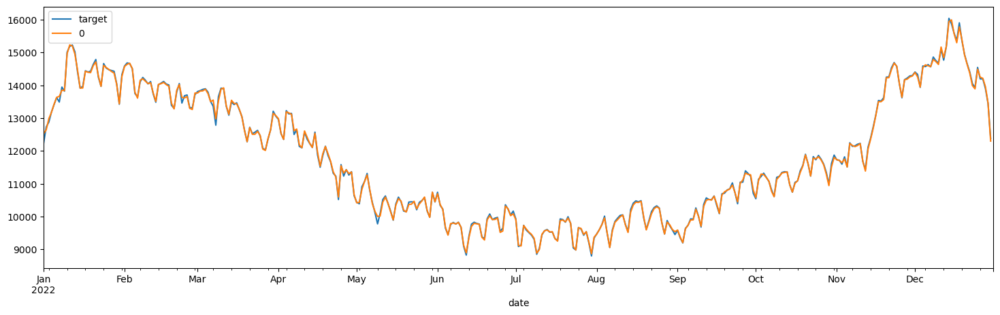

In [294]:
# Рисуем графическое представление предсказания на 2022 год

y_true_copy = pd.DataFrame(target_valid).reset_index(drop=True)
y_true_copy['day'] = y_true_copy.index // 24
y_true_grouped = y_true_copy.groupby(by='day').sum()   
y_true_grouped
y_pred_copy = pd.DataFrame(y_pred).reset_index(drop=True)
y_pred_copy['day'] = y_pred_copy.index // 24
y_pred_grouped = y_pred_copy.groupby(by='day').sum()

#pd.DataFrame(date_valid)
tmpdf = pd.DataFrame(train_ds.loc[features_valid.index,:]['date']).groupby(by='date').count().reset_index().join(y_true_grouped)
tmpdf.plot(x='date', y='target', figsize=(18,5))
ax=plt.gca()
tmpdf = pd.DataFrame(train_ds.loc[features_valid.index,:]['date']).groupby(by='date').count().reset_index().join(y_pred_grouped)
tmpdf.plot(ax=ax, x='date', y=0)

Как видно по предсказаниям, в задаче наблюдается значительная сезонность: предсказания на первый квартал 2022 года получились хуже, чем на прочие периоды. Какой сюрприз. В целом, из графического представления видно, что предказание в целом адекватно описывает динамику целевого признака.

#### 2.3 Процедурный отбор признаков
Для каждого признака проверим метрику без него и сравним с базовой метрикой, полученной со всеми признаками. Данная процедура позволит улучшить результаты за счет исключения признаков. Здесь обучение проходит на данных за 2019-2022 годы с валидацией на первом квартале 2023.

#### 2.4 График важности признаков
Визуализируем значение feature_importances_ модели

<Axes: ylabel='0'>

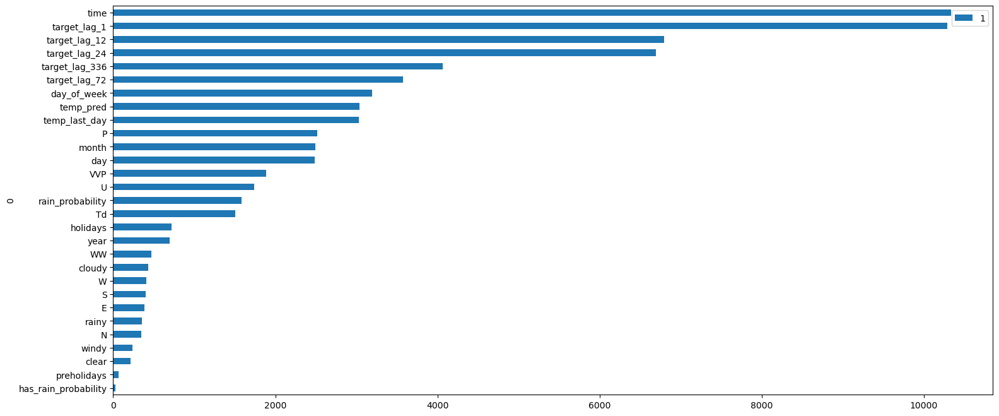

In [295]:
# График важности признаков

tmp_feature_cols = feature_cols.copy()
tmp_feature_cols.remove('date')
feature_importances = pd.DataFrame([tmp_feature_cols, lgbm_model.feature_importances_]).T.sort_values(by = 1)
feature_importances.plot(kind='barh', x=0, y=1, figsize=(18, 8))

In [296]:
features_all_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 39960 entries, 0 to 39959
Data columns (total 29 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   time                  39960 non-null  int64  
 1   temp_pred             39872 non-null  float64
 2   year                  39960 non-null  int32  
 3   month                 39960 non-null  int32  
 4   day_of_week           39960 non-null  int32  
 5   day                   39960 non-null  int32  
 6   holidays              39960 non-null  int64  
 7   preholidays           39960 non-null  int64  
 8   temp_last_day         39960 non-null  float64
 9   target_lag_1          39960 non-null  float64
 10  target_lag_12         39960 non-null  float64
 11  target_lag_24         39960 non-null  float64
 12  target_lag_72         39960 non-null  float64
 13  target_lag_336        39960 non-null  float64
 14  VVP                   39960 non-null  float64
 15  cloudy                39

### 4 Проверка метрик на тестовом датасете

In [297]:
# Проверка метрики лучшей модели на тестовом датасете
# Здесь обучаем на всем тренировочном датасете
params = {'num_leaves':15, 'learning_rate':0.02, 'feature_fraction':0.98, 'num_iterations':10000, 'random_state':random_state, 'objective':'regression_l1', 'n_jobs':-1}

lgbm_model_all_train = lgb.LGBMRegressor(**params)
lgbm_model_all_train.fit(features_all_train, target_all_train)



[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2044
[LightGBM] [Info] Number of data points in the train set: 39960, number of used features: 29
[LightGBM] [Info] Start training from score 470.665985


/opt/anaconda3/envs/p311/lib/python3.11/site-packages/lightgbm/engine.py:172: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


LGBMRegressor(feature_fraction=0.98, learning_rate=0.02, n_jobs=-1,
              num_iterations=10000, num_leaves=15, objective='regression_l1',
              random_state=12345)

In [298]:
predict_train = lgbm_model_all_train.predict(features_all_train)
predict_test = lgbm_model_all_train.predict(features_open_test)

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98


In [299]:
mae_train, mape_train, r2_train = metrics_hour(target_all_train,predict_train )
mae_open_test, mape_open_test, r2_open_test = metrics_hour(target_open_test,predict_test )

pd.DataFrame([['тренировочная на часе', mae_train, mape_train, r2_train], ['тестовая', mae_open_test, mape_open_test, r2_open_test]], 
             columns=('Выборка на часе', 'MAE', 'MAPE', 'R2'))

/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_

,Выборка на часе,MAE,MAPE,R2
0,тренировочная на часе,2.890522,0.006221,0.997703
1,тестовая,3.261117,0.007779,0.996092


In [300]:
predict_test_df = []
predictions = [0]*24  # инициализируем список для хранения последних 24 предсказаний

for i in range(len(features_open_test)):
    row = features_open_test.iloc[i]
    row_time = int(row['time'])

    if row['time'] > 0:
        row['target_lag_1'] = predictions[row_time - 1]
    if row['time'] > 11:
        row['target_lag_12'] = predictions[row_time - 12]
    #if row['time'] > 22:
    #    row['target_lag_23'] = predictions[row_time - 23]

    prediction = lgbm_model_all_train.predict(row.values.reshape(1, -1))[0]
    predict_test_df.append(prediction)
    
    # обновляем список предсказаний
    predictions[row_time] = prediction

predict_train_df = []
predictions = [0]*24  # инициализируем список для хранения последних 24 предсказаний

for i in range(len(features_all_train)):
    row = features_all_train.iloc[i]
    row_time = int(row['time'])
    
    if row['time'] > 0:
        row['target_lag_1'] = predictions[row_time - 1]
    if row['time'] > 11:
        row['target_lag_12'] = predictions[row_time - 12]
    #if row['time'] > 22:
    #    row['target_lag_23'] = predictions[row_time - 23]

    prediction = lgbm_model_all_train.predict(row.values.reshape(1, -1))[0]
    predict_train_df.append(prediction)
    
    # обновляем список предсказаний
    predictions[row_time] = prediction



/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/inde

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.98
[LightGBM] [Warning] feature_fraction is set=0.98, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_1'] = predictions[row_time - 1]
/var/folders/4y/zccbjjq17fgd73999h5g3ltr0000gn/T/ipykernel_6669/4153322485.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['target_lag_12'] = predictions[row_time - 12]


In [301]:
mae_train, mape_train, r2_train = metrics_hour(target_all_train,predict_train_df )
mae_open_test, mape_open_test, r2_open_test = metrics_hour(target_open_test,predict_test_df )

pd.DataFrame([['тренировочная на часе', mae_train, mape_train, r2_train], ['тестовая', mae_open_test, mape_open_test, r2_open_test]], 
             columns=('Выборка на часе', 'MAE', 'MAPE', 'R2'))

/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_

,Выборка на часе,MAE,MAPE,R2
0,тренировочная на часе,8.080254,0.016858,0.979417
1,тестовая,6.813506,0.015878,0.980669


In [308]:
print(f'Mae day = {mae_day(target_open_test,predict_test_df)}')

Mae day = 113.08909497738702


/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/opt/anaconda3/envs/p311/lib/python3.11/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isi

In [302]:
# Сохранение модели
lgbm_model_all_train.booster_.save_model('lgbm_model_pred.txt')

In [303]:
features_open_test.head(3)

,time,temp_pred,year,month,day_of_week,day,holidays,preholidays,temp_last_day,target_lag_1,...,rain_probability,has_rain_probability,P,U,WW,Td,N,S,W,E
39960,0,5.0,2023,4,5,1,0,0,7.2,518.685,...,58,0,750.8,100.0,1.0,7.0,0.0,1.0,0.0,0.5
39961,1,5.0,2023,4,5,1,0,0,7.2,479.282,...,58,0,750.8,100.0,1.0,7.0,0.0,1.0,0.0,0.0
39962,2,5.0,2023,4,5,1,0,0,7.2,445.182,...,58,0,750.1,100.0,1.0,8.0,0.0,1.0,0.0,0.0


In [304]:
target_open_test.head(3)

39960    479.282
39961    445.182
39962    424.225
Name: target, dtype: float64

In [305]:
predict_test

array([482.74791283, 448.25385679, 422.72656314, ..., 444.59113358,
       446.54745873, 427.50217364])

In [306]:
predict_train_df

[266.10386900184665,
 261.9025445184814,
 259.79945502933816,
 260.1679931991121,
 257.9020269105902,
 254.7961459079199,
 255.24229434683193,
 274.55023806258635,
 313.7810846944833,
 356.7402665772975,
 386.7341519317107,
 407.1948924999633,
 416.16910570800667,
 417.71215959732376,
 422.72537891923133,
 427.537618105343,
 436.99222100958355,
 443.34146898658355,
 456.396712219486,
 463.8230212412596,
 469.4735724168206,
 473.6590596445154,
 478.99757870306473,
 463.20969153614226,
 465.8445985188778,
 438.209331825877,
 416.1579915750697,
 402.3683336610507,
 393.7911572897026,
 392.9062911787119,
 404.36266031536894,
 425.35205722340703,
 442.9360348469595,
 468.7860244853505,
 495.17276613312487,
 517.393200625065,
 525.5227728634898,
 524.6408004676152,
 524.2581140945141,
 523.8687025311655,
 524.1226417613024,
 530.0130190788128,
 542.4740973512088,
 547.3626539869738,
 548.7469750590044,
 544.7448695501879,
 532.2216314460014,
 509.6325771939863,
 475.568081687269,
 448.806531